In [1]:
import numpy as np
import pandas as pd
from pathlib import Path

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
path_results = Path("../data/results/")

In [3]:
cv = "cv3"

all_oof = {
    "lightgbm": pd.read_parquet(path_results / f"oof_lightgbm_int97_{cv}.parquet"),
    "lightgbm_linear": pd.read_parquet(path_results / f"oof_lightgbm_linear_uni95_{cv}.parquet"),
    "xgboost": pd.read_parquet(path_results / f"oof_xgboost_uni85_{cv}.parquet"), 
    "catboost": pd.read_parquet(path_results / f"oof_catboost_text_uni90_{cv}.parquet"),
    # "dt_nn": pd.read_parquet(path_results / f"oof_dt-nn_int97_{cv}.parquet"),
    "mlp": pd.read_parquet(path_results / f"oof_nn-mlp_full_{cv}.parquet"),
    "1dcnn": pd.read_parquet(path_results / f"oof_nn-1dcnn_uni80_{cv}.parquet"),
    "gandalf": pd.read_parquet(path_results / f"oof_nn-gandalf_uni80_{cv}.parquet"),
}

combined_df = all_oof["lightgbm"][["utility_agent1_true","fold"]]
for model, df in all_oof.items():
    combined_df[f'utility_agent1_pred_{model}'] = df['utility_agent1_pred']

combined_df = combined_df.dropna(subset=["fold"], ignore_index=True)
combined_df["fold"] = combined_df["fold"].astype(int)
combined_df

,utility_agent1_true,fold,utility_agent1_pred_lightgbm,utility_agent1_pred_lightgbm_linear,utility_agent1_pred_xgboost,utility_agent1_pred_catboost,utility_agent1_pred_mlp,utility_agent1_pred_1dcnn,utility_agent1_pred_gandalf
0,-0.466667,2,-0.312711,-0.343538,-0.318042,-0.029965,-0.094843,-0.276219,-0.136363
1,-0.333333,2,-0.067989,-0.130576,-0.004106,0.084548,-0.070022,-0.164031,0.045940
2,-0.066667,2,0.028722,0.110679,0.095952,0.306912,0.008187,0.223735,0.189640
3,-0.333333,2,-0.027028,0.038348,0.058418,0.108349,-0.040835,-0.061926,0.183484
4,-0.333333,2,0.053506,0.117267,0.063937,0.183679,0.022453,0.035779,-0.073455
...,...,...,...,...,...,...,...,...,...
208603,-0.733333,3,-0.455402,-0.408042,-0.440980,-0.468352,-0.584037,-0.269790,-0.299810
208604,0.266667,3,-0.233319,-0.216536,-0.224151,-0.153442,-0.209725,-0.271315,-0.190258
208605,0.666667,3,0.005615,0.040002,0.022209,0.142693,-0.140508,-0.010889,0.162927
208606,0.666667,3,-0.044354,-0.070769,-0.106552,0.049260,-0.145175,-0.021357,0.168281


In [4]:
# Create a long-form DataFrame for plotting
melted_df = combined_df.melt(
    value_vars=[
        'utility_agent1_pred_lightgbm', 
        'utility_agent1_pred_lightgbm_linear',
        'utility_agent1_pred_xgboost', 
        'utility_agent1_pred_catboost',
        # ---------
        'utility_agent1_pred_mlp',
        'utility_agent1_pred_1dcnn',
        'utility_agent1_pred_gandalf',
        'utility_agent1_true',

    ],
    var_name='Model',
    value_name='Utility Agent 1'
)

# Map model names for better labels
model_mapping = {
    'utility_agent1_pred_lightgbm': 'LightGBM',
    'utility_agent1_pred_lightgbm_linear': 'LightGBM Linear',
    'utility_agent1_pred_xgboost': 'XGBoost',
    'utility_agent1_pred_catboost': 'CatBoost',
    # ---------
    'utility_agent1_pred_mlp': "MLP",
    'utility_agent1_pred_1dcnn': '1DCNN',
    'utility_agent1_pred_gandalf': 'gandalf',
    'utility_agent1_true': 'True Values'
}
melted_df['Model'] = melted_df['Model'].map(model_mapping)

# Create a distribution plot for each model's predictions using Plotly Express
fig = px.histogram(
    melted_df, 
    x='Utility Agent 1', 
    color='Model',
    histnorm='percent',
    opacity=0.66,
    nbins=100,
    title='Distribution of Predictions for Each Model',
    labels={'Utility Agent 1': 'Utility Agent 1'}
)

fig.update_layout(
    barmode='overlay',
    xaxis_title='Utility Agent 1',
    yaxis_title='Percent',
    legend_title='Model'
)
fig.show()


Correlation matrix between model predictions:
                                     utility_agent1_pred_lightgbm  \
utility_agent1_pred_lightgbm                             1.000000   
utility_agent1_pred_lightgbm_linear                      0.971359   
utility_agent1_pred_xgboost                              0.966679   
utility_agent1_pred_catboost                             0.935027   
utility_agent1_pred_mlp                                  0.895457   
utility_agent1_pred_1dcnn                                0.901942   
utility_agent1_pred_gandalf                              0.900068   

                                     utility_agent1_pred_lightgbm_linear  \
utility_agent1_pred_lightgbm                                    0.971359   
utility_agent1_pred_lightgbm_linear                             1.000000   
utility_agent1_pred_xgboost                                     0.962557   
utility_agent1_pred_catboost                                    0.926717   
utility_agent1_pred_m

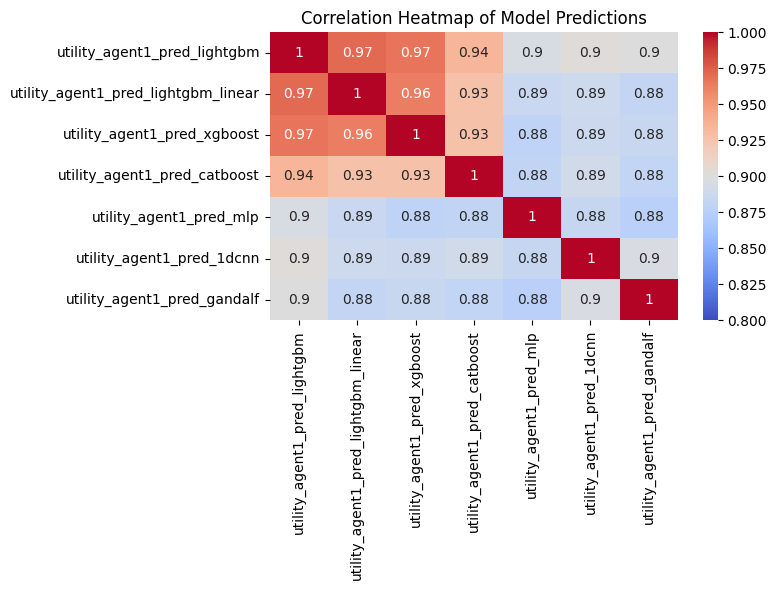


Correlation between true values and predictions:
utility_agent1_pred_lightgbm           0.688250
utility_agent1_pred_lightgbm_linear    0.675729
utility_agent1_pred_xgboost            0.677856
utility_agent1_pred_catboost           0.698491
utility_agent1_pred_mlp                0.675018
utility_agent1_pred_1dcnn              0.693910
utility_agent1_pred_gandalf            0.679147
Name: utility_agent1_true, dtype: float64


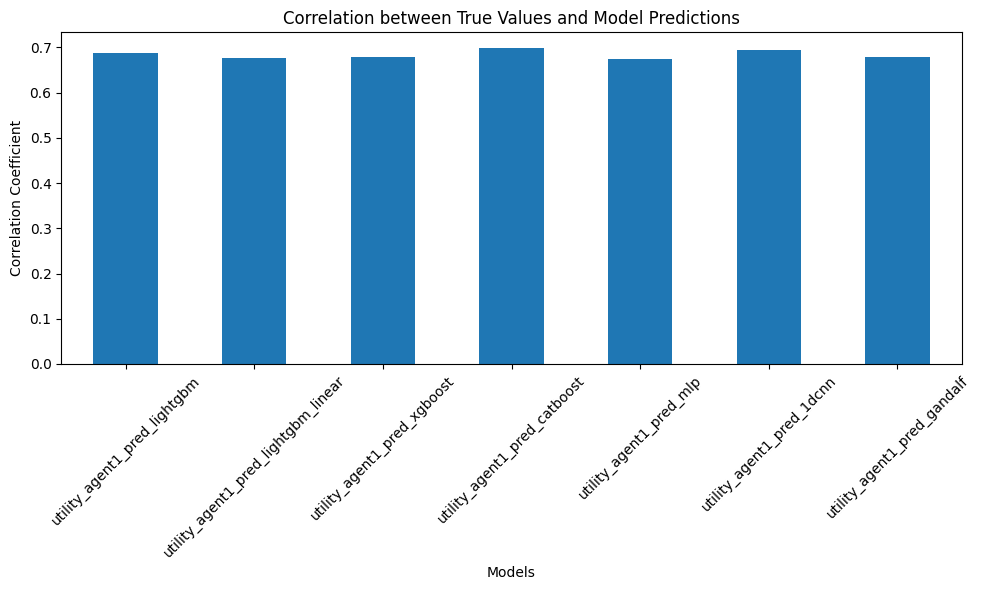

In [5]:
# Calculate correlation between model predictions
correlation_matrix = combined_df.filter(like='pred').corr()

# Display the correlation matrix
print("Correlation matrix between model predictions:")
print(correlation_matrix)

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=0.8, vmax=1)
plt.title('Correlation Heatmap of Model Predictions')
plt.tight_layout()
plt.show()

# Calculate correlation between true values and predictions
true_vs_pred_corr = combined_df.corr()['utility_agent1_true'].filter(like='pred')

print("\nCorrelation between true values and predictions:")
print(true_vs_pred_corr)

# Visualize the correlation between true values and predictions
plt.figure(figsize=(10, 6))
true_vs_pred_corr.plot(kind='bar')
plt.title('Correlation between True Values and Model Predictions')
plt.xlabel('Models')
plt.ylabel('Correlation Coefficient')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

***